<a href="https://colab.research.google.com/github/SmittyB00p/7K6l06Ibrll2Q4f5/blob/main/text_extraction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Text Extraction from Images

Using a few images from The New American Bible this notebook looks at early model used for text extraction (Idefics) and a more recent model (Google Gemini 2.0).

Why I chose the Bible as images to extract text from, is that I could retrieve the 'actual' text from the Vatican's website so as to have a good marker for comparison.

Early text-to-speech (TTS) models will be used later on in the notebook for speech synthesis.

In [1]:
%%capture
!pip install pillow_heif
!pip install -U bitsandbytes peft flash
!pip install speechbrain
!pip install torchcodec
# !pip install -U flash-attn --no-build-isolation

In [2]:
import os
import sys
import requests
from pathlib import Path
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from matplotlib import image as mpimg
from PIL import Image
from pillow_heif import register_heif_opener

from transformers import BitsAndBytesConfig

import torchcodec
import torch
import torchvision
import torch.nn as nn
from torch.nn import functional as F
import torch.optim as optim
from torch.optim import lr_scheduler
import torch.backends.cudnn as cudnn
from torchvision import datasets
from torchvision.io import decode_image
from torchvision.transforms import v2
from transformers import AutoProcessor, AutoModelForVision2Seq

In [3]:
## images for testing the Idefics Model
path_to_images = str(Path(os.getcwd()+'/drive/MyDrive/extraction_images'))
non_string_path_to_images = Path(os.getcwd()+'/drive/MyDrive/extraction_images')

images_list = os.listdir(path_to_images)

## images from MonReader Project
path_to_training_images = str(Path(os.getcwd()+'/drive/MyDrive/images/training/notflip'))
non_string_path_to_training_images = Path(os.getcwd()+'/drive/MyDrive/images/training/notflip')

training_images_list = os.listdir(path_to_training_images)

In [4]:
## gets random image from the MonReader images
random_image = np.random.choice(training_images_list)

In [5]:
def get_random_image(path_to_training_images:str):
  '''
  -- Parameters --
  path_to_training_images: path to images folder

  -- Returns --
  cropped and resized image

  '''
  random_image = np.random.choice(os.listdir(path_to_training_images))

  img = Image.open(path_to_training_images+'/'+random_image)
  # print(f"Shape of image: {np.array(Image.open(path_to_training_images+'/'+image)).shape}\n")

  img = img.crop((50, 350, 1100, 1500))
  img = img.resize((980, 980))
  plt.figure(figsize=(12,12))
  plt.imshow(img)
  plt.show()

  # print(f"Shape of image resized image: {np.array(img).shape}")


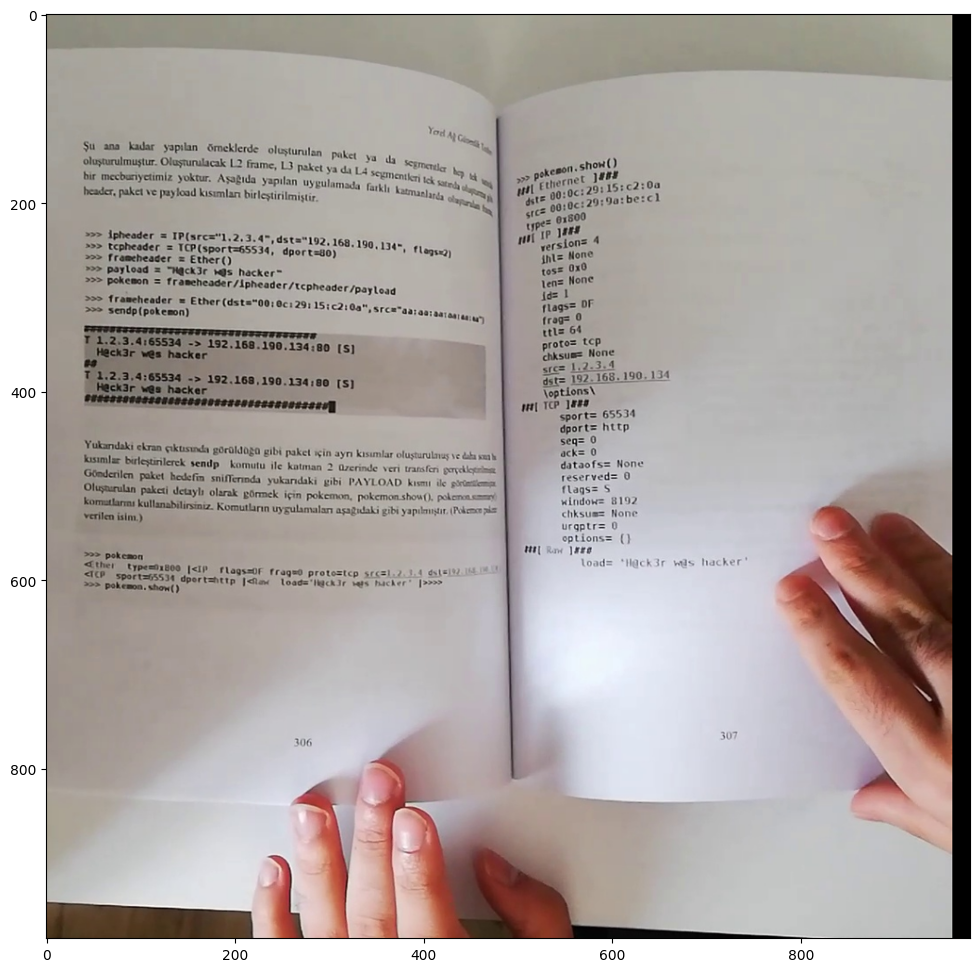

In [6]:
get_random_image(path_to_training_images)

In [7]:
# for image in images_list:
#   print(image)

In [8]:
## function for converting images from HEIF to JPG

def heif_to_jpg(image_path, remove=False):
  '''
  -- Parameters --
  image_path: PoxisPath to folder containing images to be converted
  remove: set to True if you want to remove the old HEIF images. Default = False

  -- Returns --
  saves new images to image_path

  '''

  register_heif_opener()

  for image in image_path.rglob("*.[hH][eE][iI][Cc]"):
    pillow_heif_image = Image.open(image)

    new_image = f"{image.stem}.jpg"

    print(f"New image '{new_image}' being saved to {image_path}")
    pillow_heif_image.convert('RGB').save(f"drive/MyDrive/extraction images/{new_image}")

    if remove == True:
      os.remove(image)

In [9]:
# heif_to_jpg(Path(os.getcwd()+'/drive/MyDrive/extraction images'), remove=True)

In [10]:
# for image in os.listdir(path_to_images):
#   if image.endswith('.jpg'):
#     image = mpimg.imread(path_to_images+'/'+image)
#     plt.figure(figsize=(12,12))
#     plt.imshow(image)
#     plt.show()

In [11]:
## resize images for modeling

def resize_image(image_path=str(), size=int()):
  '''
  -- Parameters --
  image_path: path to folder containing images to be resized
  size: size to resize images to. The image will be square e.g. (size x size)

  -- Returns --
  saves new image to image_path
  '''

  for image in os.listdir(image_path):
    if image.endswith('.jpg'): ## this will have to get fixed to make sure anything between the _ and .jpg gets excluded
      print(f"Image name: {image}")
      img = Image.open(image_path+'/'+image)
      img = img.resize((size, size))
      img.save(f"drive/MyDrive/extraction images/{image[:8]}_resize.jpg")

In [12]:
# resize_image(path_to_images, size=980)

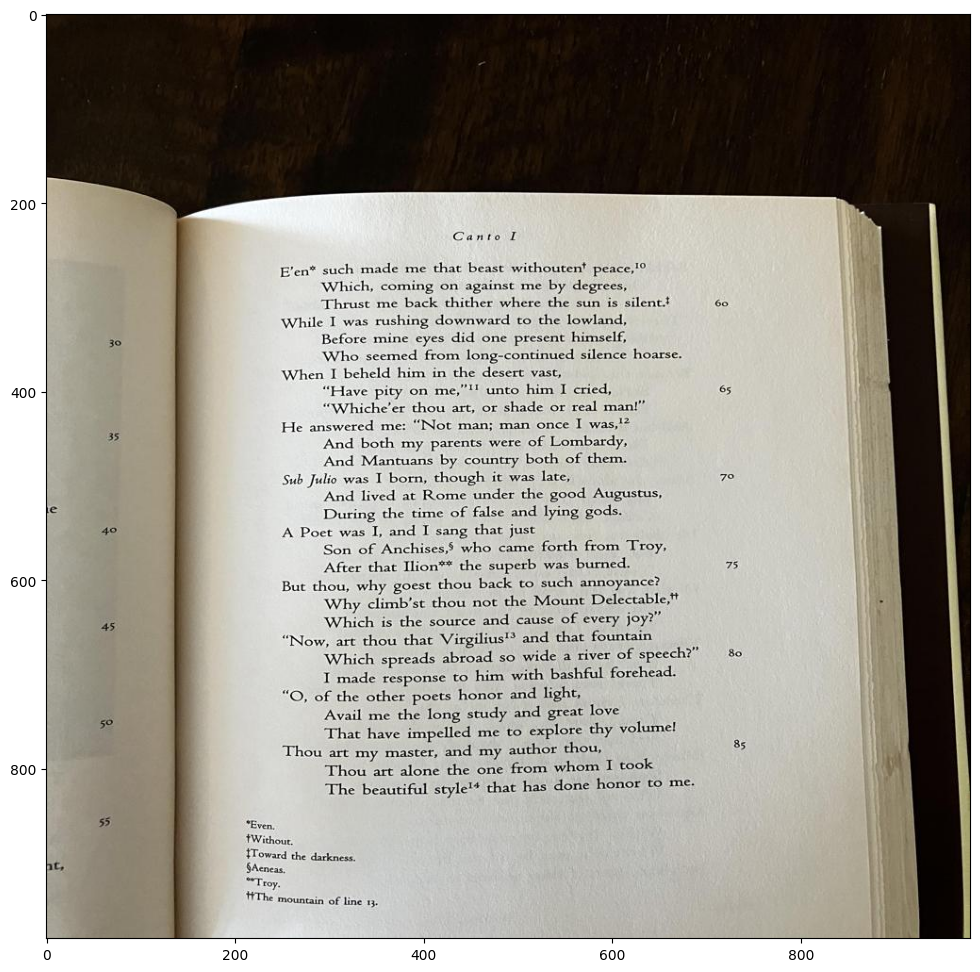

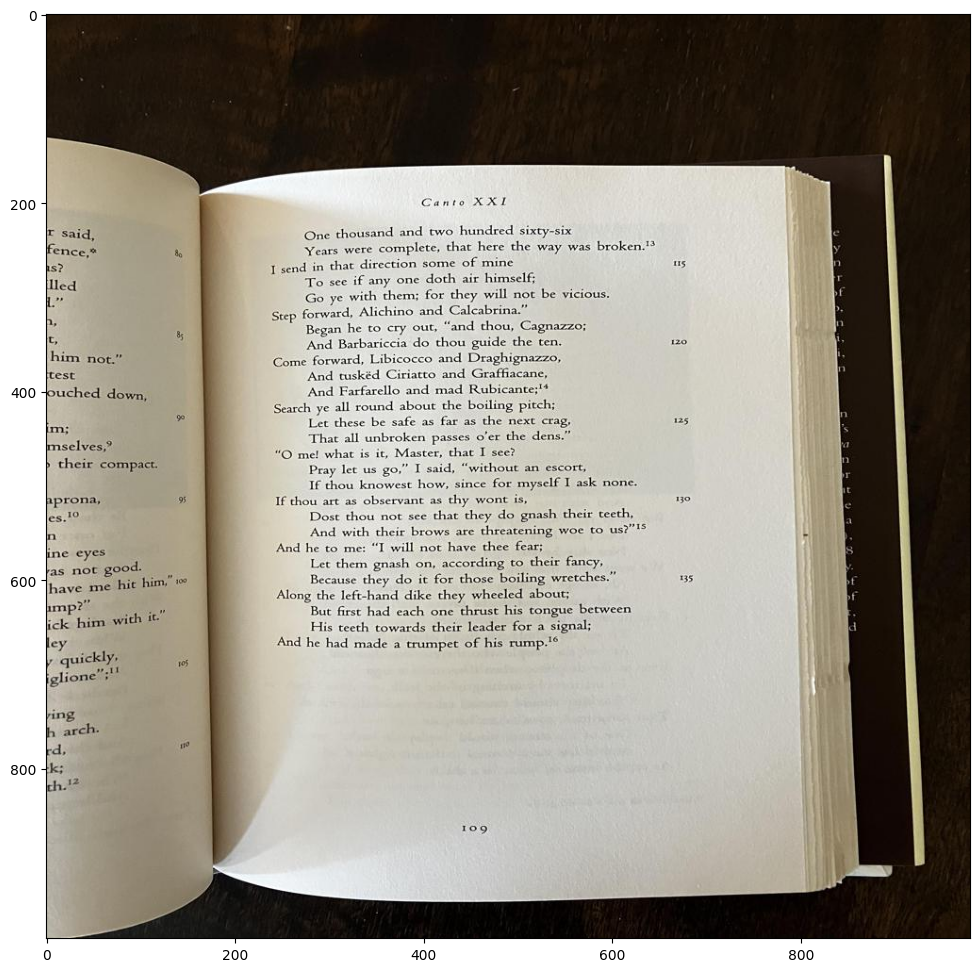

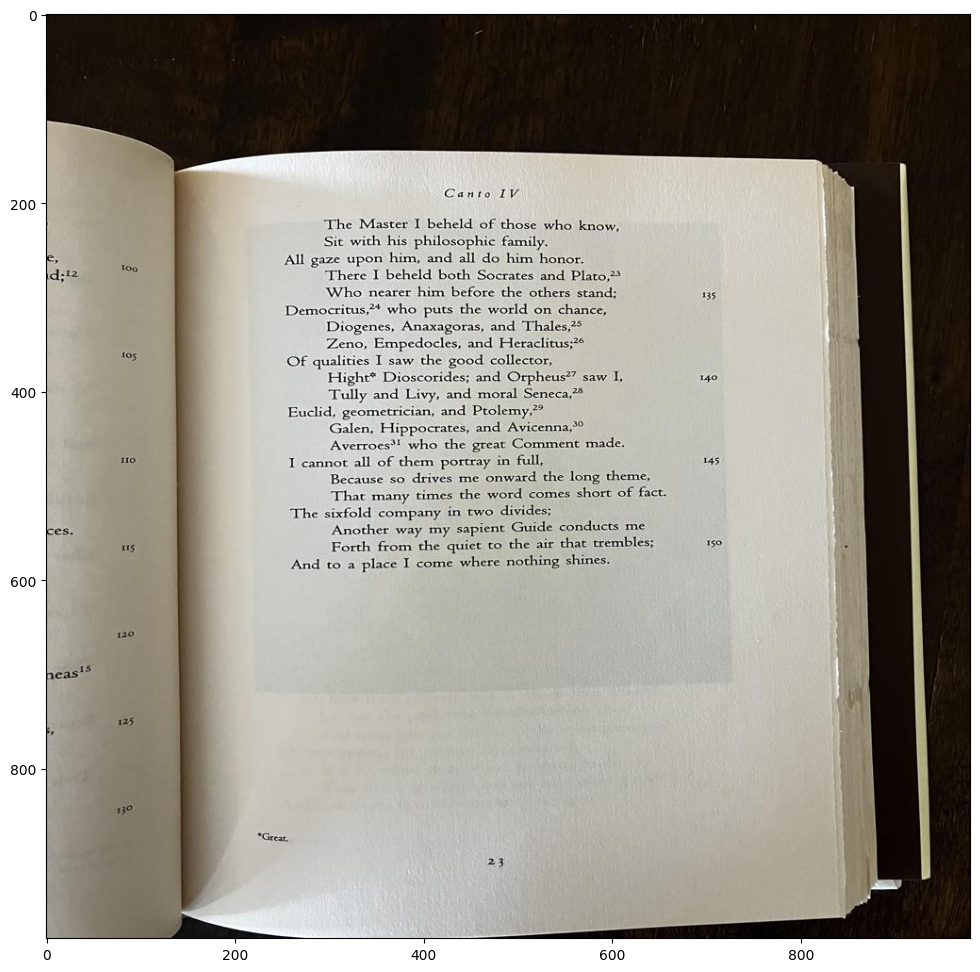

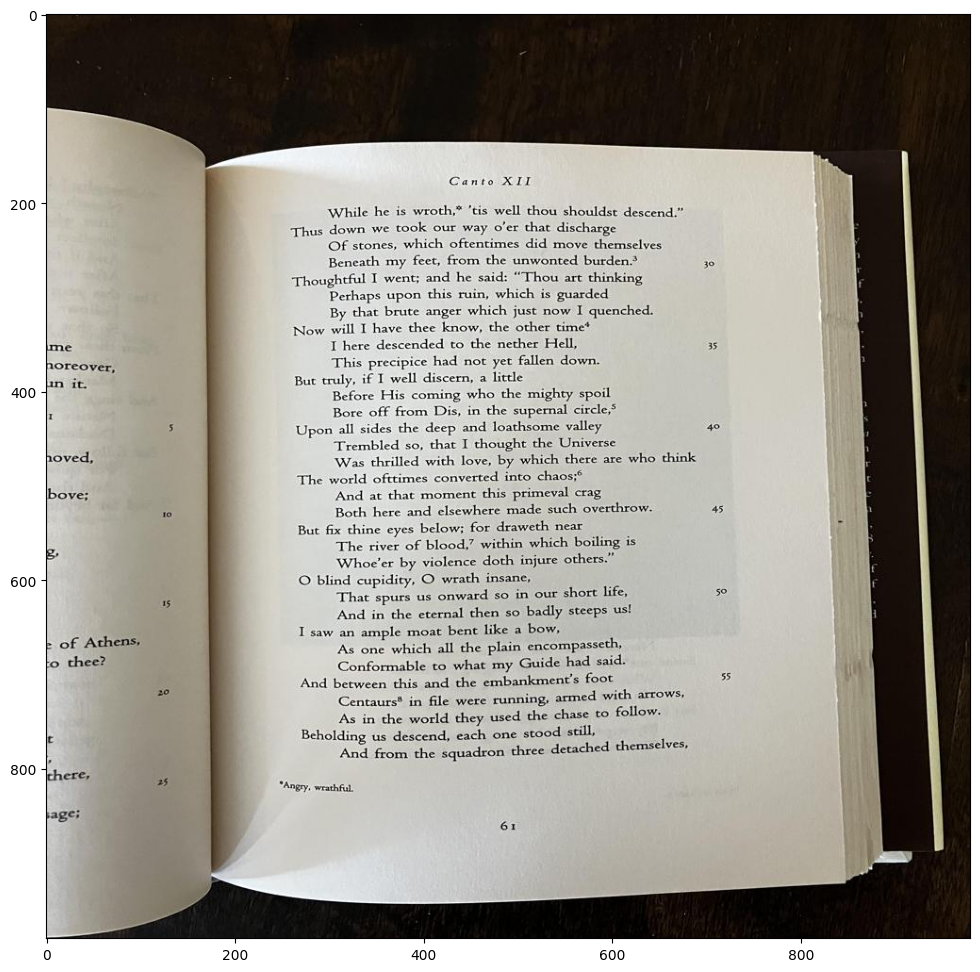

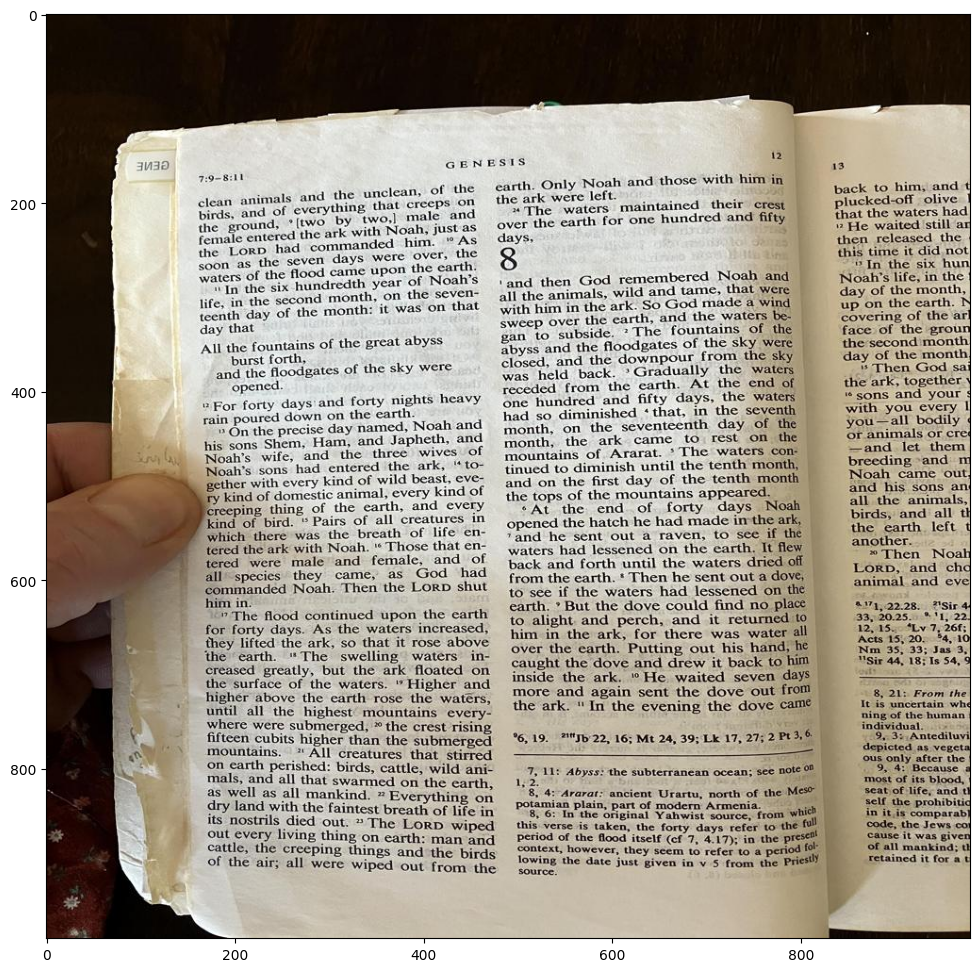

...

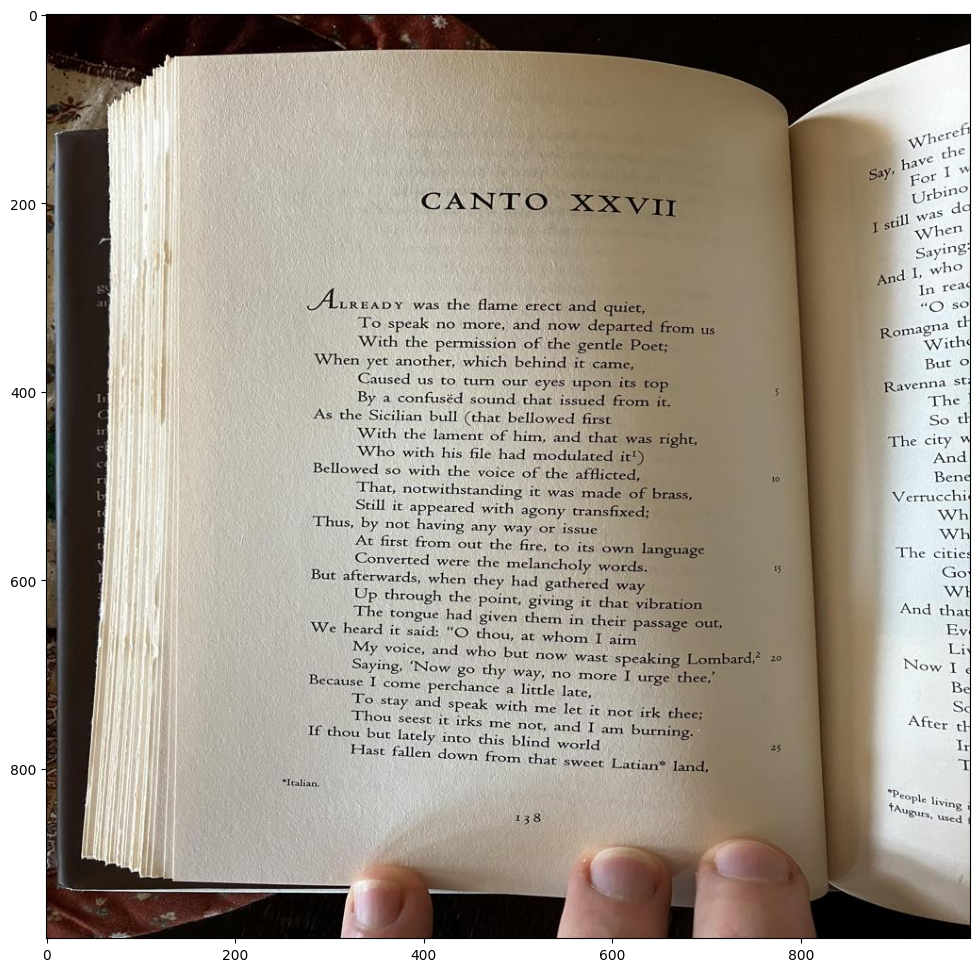

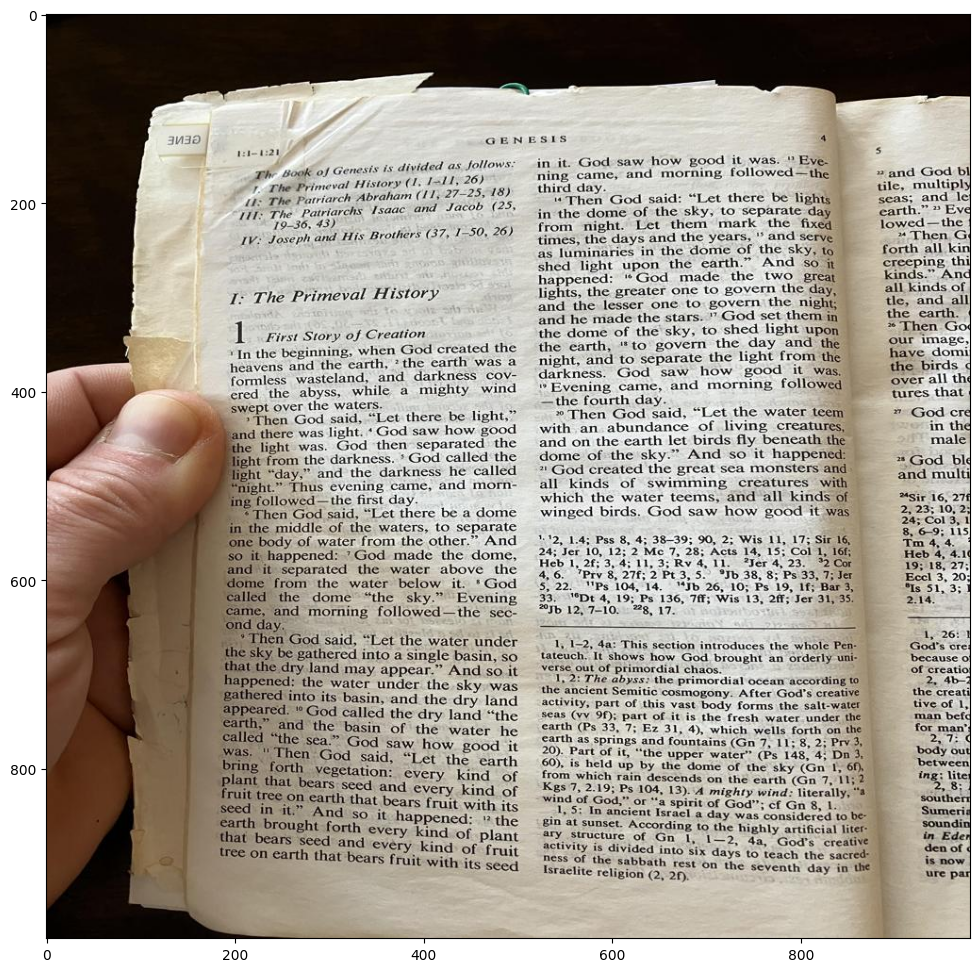

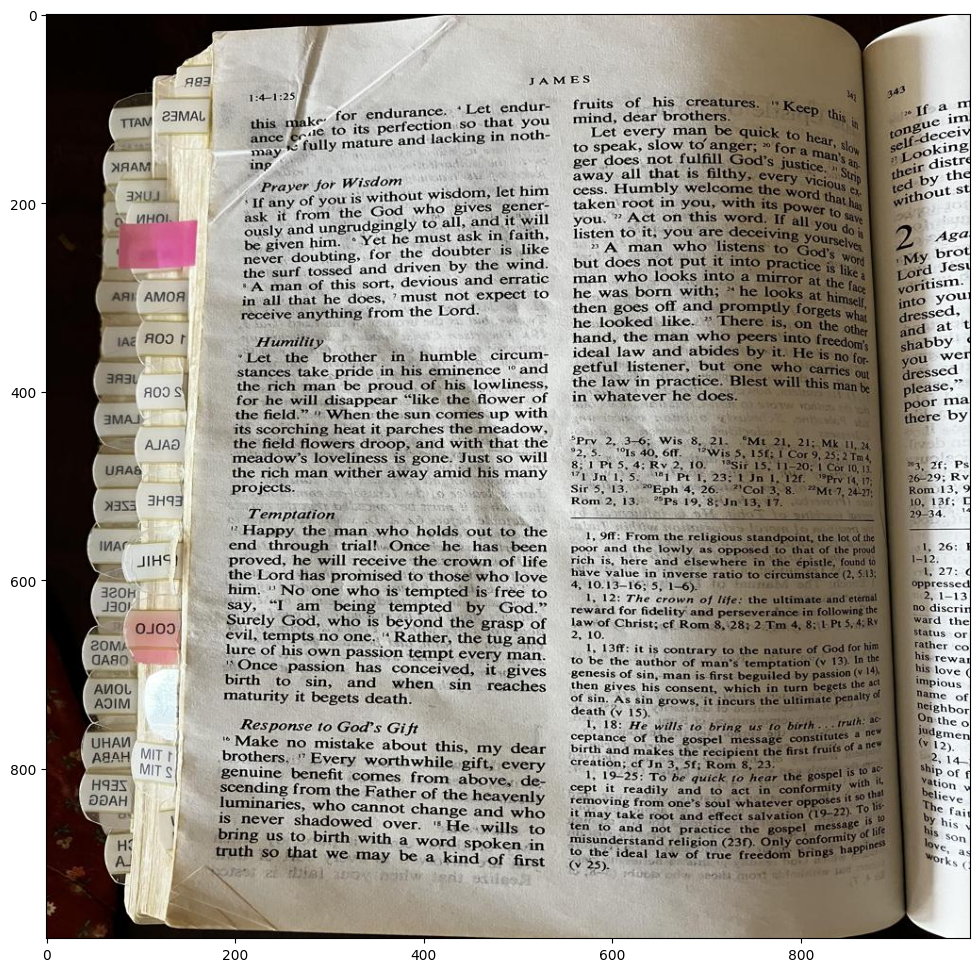

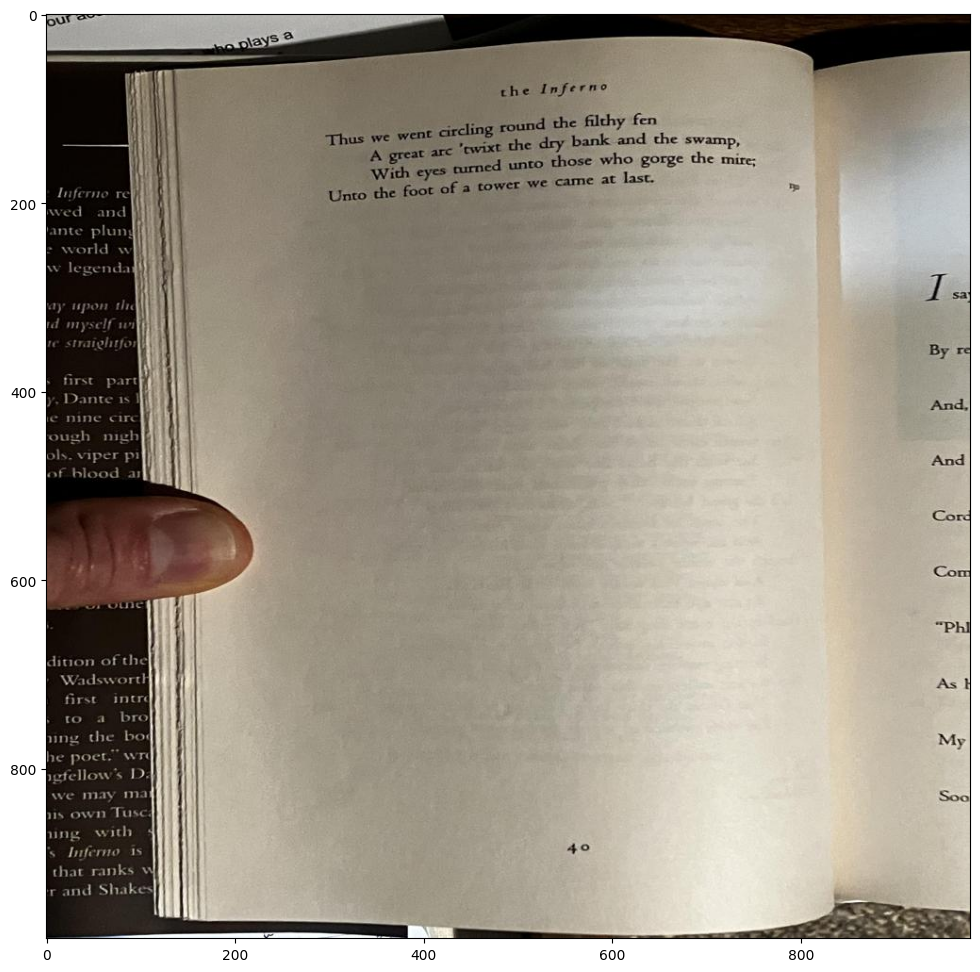

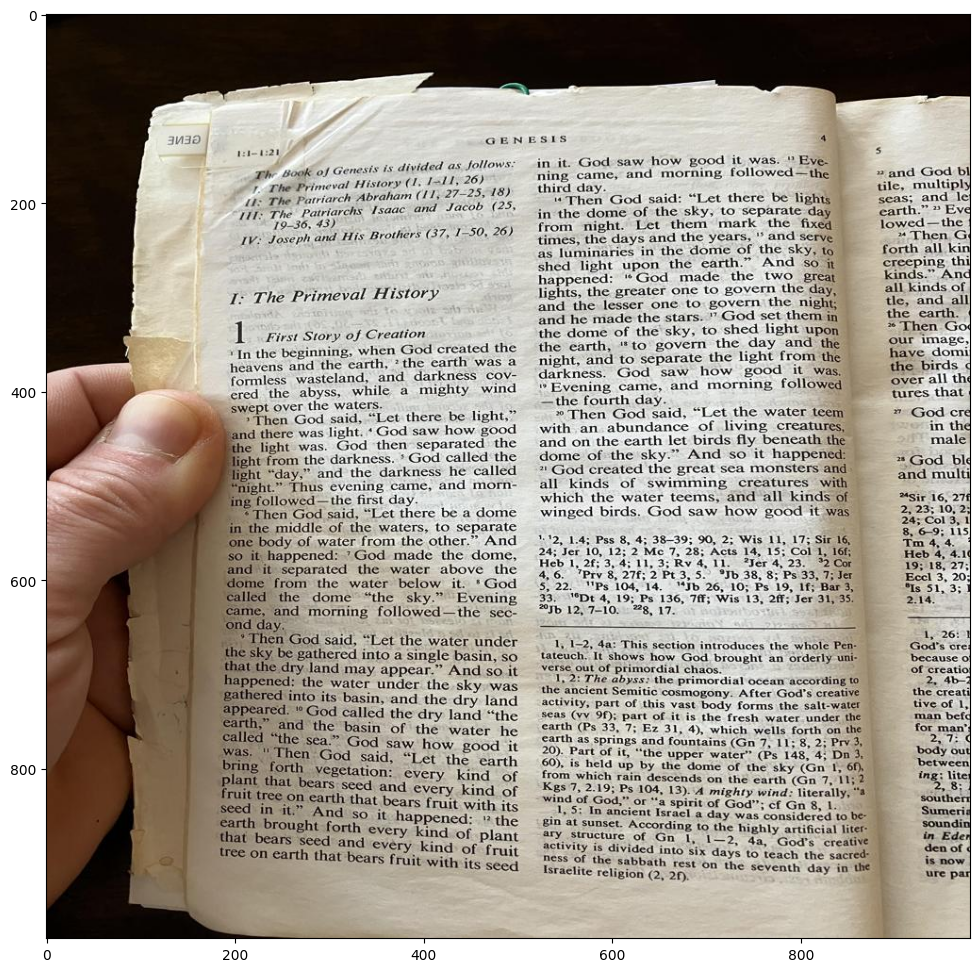

In [13]:
for image in os.listdir(path_to_images):
  if image.endswith('_resize.jpg'):
    img = Image.open(path_to_images+'/'+image)
    plt.figure(figsize=(12,12))
    plt.imshow(img)
    plt.show()

In [14]:
resized_images = [Image.open(path_to_images+'/'+image) for image in images_list if image.endswith('_resize.jpg')]

In [15]:
genesis1 = resized_images[8]
exodus20 = resized_images[6]
canto1 = resized_images[0]

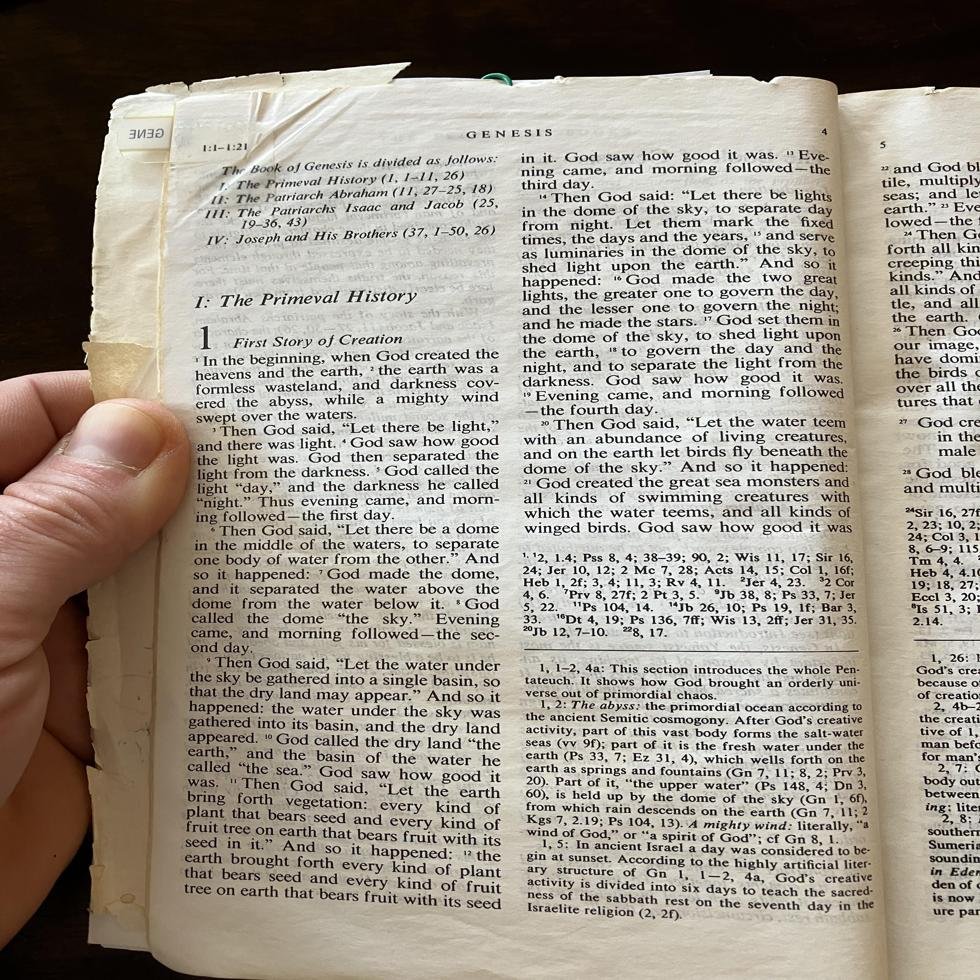

In [16]:
genesis1

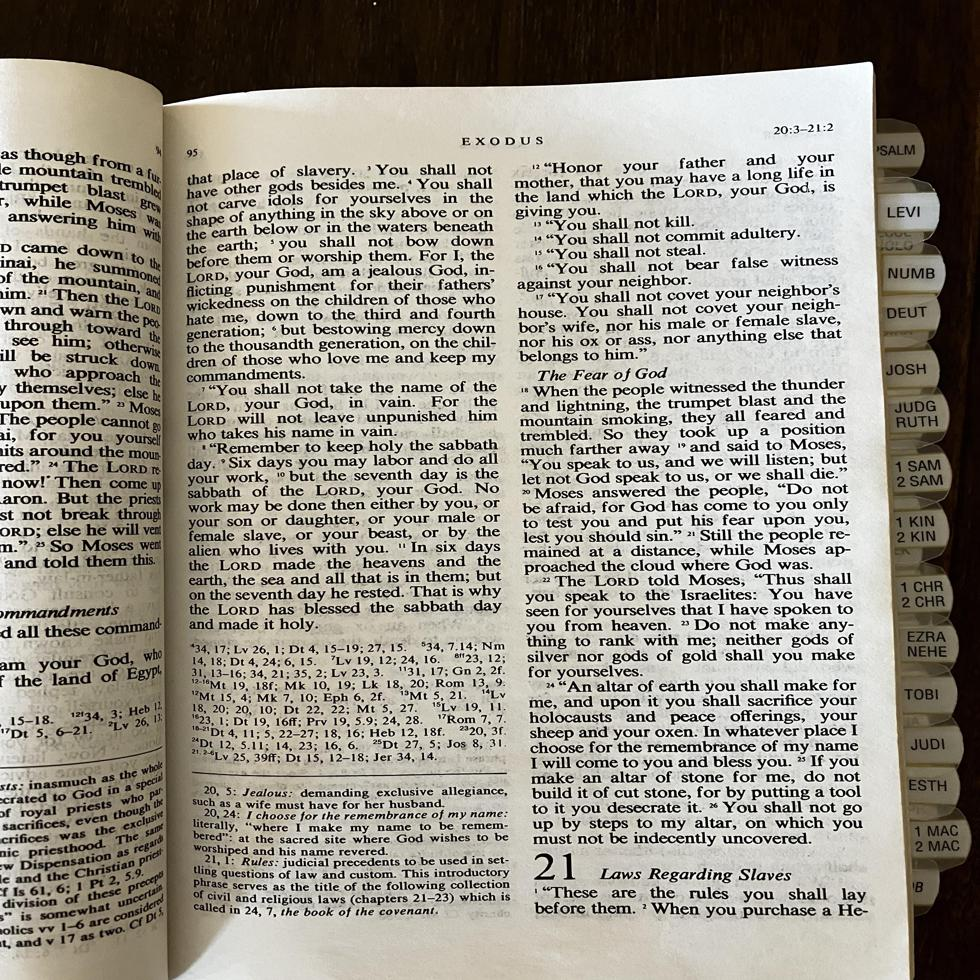

In [17]:
exodus20

## Idefics3
https://huggingface.co/docs/transformers/en/model_doc/idefics3



In [18]:
## load in model and processor
from peft import LoraConfig

processor = AutoProcessor.from_pretrained("HuggingFaceM4/Idefics3-8B-Llama3")
model = AutoModelForVision2Seq.from_pretrained("HuggingFaceM4/Idefics3-8B-Llama3",
                                              torch_dtype=torch.bfloat16,
                                              #  attn_implementation="flash_attention_2",
                                              device_map="auto")

lora_config = LoraConfig(
        r=8,
        lora_alpha=8,
        lora_dropout=0.1,
        target_modules='.*(text_model|modality_projection|perceiver_resampler).*(down_proj|gate_proj|up_proj|k_proj|q_proj|v_proj|o_proj).*$',
        use_dora=False,
        init_lora_weights="gaussian"
    )

model.add_adapter(lora_config)
model.enable_adapters()

preprocessor_config.json:   0%|          | 0.00/435 [00:00<?, ?B/s]

tokenizer_config.json: 0.00B [00:00, ?B/s]

tokenizer.json: 0.00B [00:00, ?B/s]

special_tokens_map.json:   0%|          | 0.00/951 [00:00<?, ?B/s]

chat_template.json:   0%|          | 0.00/434 [00:00<?, ?B/s]

/usr/local/lib/python3.12/dist-packages/transformers/models/auto/modeling_auto.py:2199: FutureWarning: The class `AutoModelForVision2Seq` is deprecated and will be removed in v5.0. Please use `AutoModelForImageTextToText` instead.
  warnings.warn(


config.json: 0.00B [00:00, ?B/s]

model.safetensors.index.json: 0.00B [00:00, ?B/s]

Fetching 4 files:   0%|          | 0/4 [00:00<?, ?it/s]

model-00004-of-00004.safetensors:   0%|          | 0.00/2.04G [00:00<?, ?B/s]

model-00001-of-00004.safetensors:   0%|          | 0.00/4.97G [00:00<?, ?B/s]

model-00002-of-00004.safetensors:   0%|          | 0.00/5.00G [00:00<?, ?B/s]

model-00003-of-00004.safetensors:   0%|          | 0.00/4.92G [00:00<?, ?B/s]

Loading checkpoint shards:   0%|          | 0/4 [00:00<?, ?it/s]

generation_config.json:   0%|          | 0.00/198 [00:00<?, ?B/s]

In [19]:
os.environ['PYTORCH_CUDA_ALLOC_CONF']='expandable_segments:True'

In [20]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

print(os.environ['PYTORCH_CUDA_ALLOC_CONF'])

model.to(device)

expandable_segments:True


Idefics3ForConditionalGeneration(
  (model): Idefics3Model(
    (vision_model): Idefics3VisionTransformer(
      (embeddings): Idefics3VisionEmbeddings(
        (patch_embedding): Conv2d(3, 1152, kernel_size=(14, 14), stride=(14, 14), padding=valid)
        (position_embedding): Embedding(676, 1152)
      )
      (encoder): Idefics3Encoder(
        (layers): ModuleList(
          (0-26): 27 x Idefics3EncoderLayer(
            (self_attn): Idefics3VisionAttention(
              (k_proj): Linear(in_features=1152, out_features=1152, bias=True)
              (v_proj): Linear(in_features=1152, out_features=1152, bias=True)
              (q_proj): Linear(in_features=1152, out_features=1152, bias=True)
              (out_proj): Linear(in_features=1152, out_features=1152, bias=True)
            )
            (layer_norm1): LayerNorm((1152,), eps=1e-06, elementwise_affine=True)
            (mlp): Idefics3VisionMLP(
              (activation_fn): PytorchGELUTanh()
              (fc1): Linear(in_

In [21]:
messages = [
    {
        "role": "user",
        "content": [
            {"type": "text",
             "text": "Extract the text that is on the open page of the image. Do not add any extra text or special characters to your response. If sentences are incomplete, do not extract that text in your response."},
            {"type": "image"},
            {"type": "text", "text": "Extract the text that is on the page in the image and nothing else. Do not include the initial prompt."},
]},
]

text = processor.apply_chat_template(messages, add_generation_prompt=False)
# print(text)

In [22]:
prompts = [processor.apply_chat_template([message], add_generation_prompt=True) for message in messages]
images = [genesis1]
inputs = processor(text=prompts, images=images, padding=True, return_tensors="pt").to(model.device)

generated_ids = model.generate(**inputs, max_new_tokens=1000)
generated_texts = processor.batch_decode(generated_ids, skip_special_tokens=True)
generated_texts[0]

'User: Extract the text that is on the open page of the image. Do not add any extra text or special characters to your response. If sentences are incomplete, do not extract that text in your response.<image>Extract the text that is on the page in the image and nothing else. Do not include the initial prompt.\nAssistant: 1. In the beginning, when God created the earth, and the earth was formless and empty, and darkness covered the deep, and the Spirit of God was hovering over the waters, there was light. God saw how good it was. And God separated the light from the darkness. God called the light "day" and the darkness he called "night." Evening came, and morning followed—the first day. 2. And God said, "Let there be a vault between the waters above and the waters below. It will separate the waters above from the waters below. It will be a sign between the waters below and the waters above. It will serve as a sign to distinguish between day and night. And it will be so." And it was so. 3

In [23]:
generated_texts[0][320:]

'1. In the beginning, when God created the earth, and the earth was formless and empty, and darkness covered the deep, and the Spirit of God was hovering over the waters, there was light. God saw how good it was. And God separated the light from the darkness. God called the light "day" and the darkness he called "night." Evening came, and morning followed—the first day. 2. And God said, "Let there be a vault between the waters above and the waters below. It will separate the waters above from the waters below. It will be a sign between the waters below and the waters above. It will serve as a sign to distinguish between day and night. And it will be so." And it was so. 3. God called the vault "the sky." Evening came, and morning followed—the second day. 4. And God said, "Let the waters below the sky be gathered into one place, and let the dry land appear." And it was so. 5. God called the dry land "earth," and the gathering of the waters he called "seas." And God saw how good it was. 6

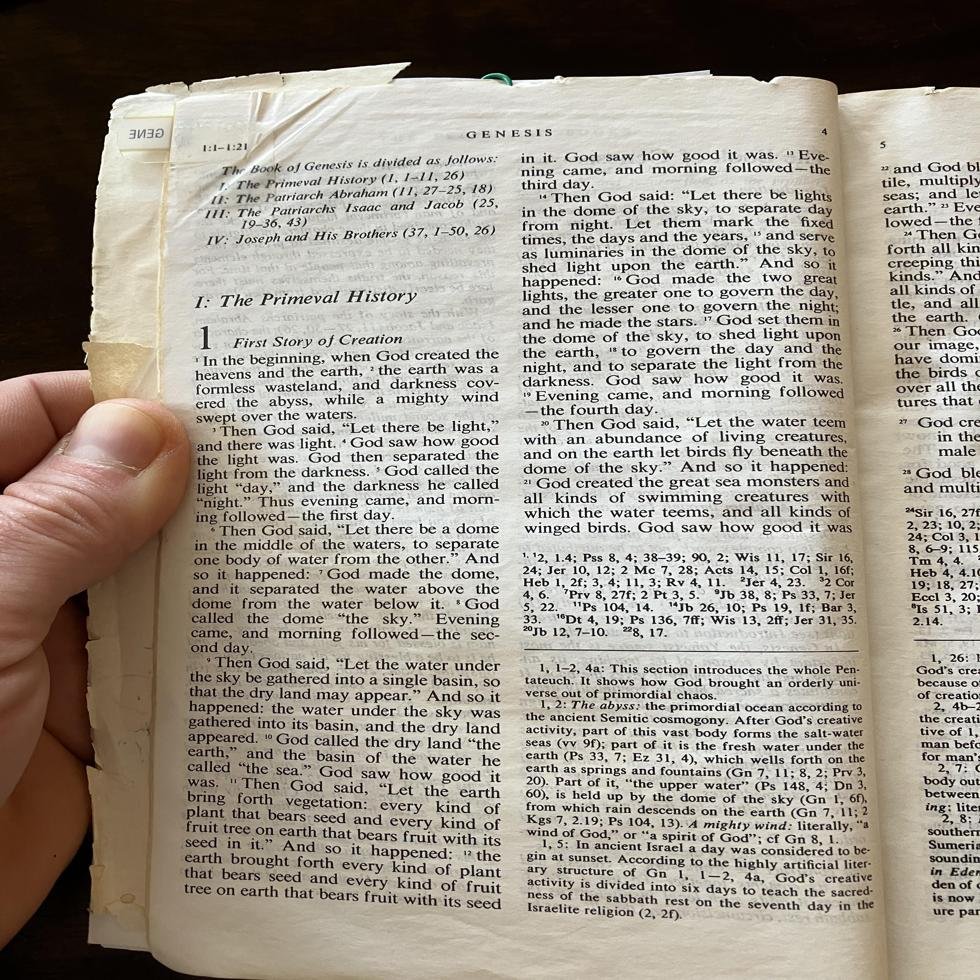

In [24]:
genesis1

In [25]:
 ## ground truth text from Vatican website
import regex as re
with open('drive/MyDrive/vatican_genesis1_and_2.txt', 'r') as file:
  lines = file.readlines()
  lines = [re.sub(r'\s', ' ', line) for line in lines]

lines[:10]

['First Story of Creation ',
 ' ',
 '1 In the beginning, when God created the heavens and the earth, ',
 '2 the earth was a formless wasteland, and darkness covered the abyss, while a mighty wind swept over the waters. ',
 '3 Then God said, "Let there be light," and there was light. ',
 '4 God saw how good the light was. God then separated the light from the darkness. ',
 '5 God called the light "day," and the darkness he called "night." Thus evening came, and morning followed - the first day. ',
 '6 Then God said, "Let there be a dome in the middle of the waters, to separate one body of water from the other." And so it happened: ',
 '7 God made the dome, and it separated the water above the dome from the water below it. ',
 '8 God called the dome "the sky." Evening came, and morning followed - the second day. ']

In [26]:
genesis1_ground_truth_list = ''.join(lines).split()
genesis1_ground_truth_list[:10]

['First',
 'Story',
 'of',
 'Creation',
 '1',
 'In',
 'the',
 'beginning,',
 'when',
 'God']

In [27]:
## https://machinelearningmastery.com/calculate-bleu-score-for-text-python/

from nltk.translate.bleu_score import sentence_bleu

genesis_bleu_score_idefics = sentence_bleu([genesis1_ground_truth_list], generated_texts[0][320:].split())
print(f"Idefics model bleu score with Genesis1 image: {round(genesis_bleu_score_idefics, 4)*100}%")

Idefics model bleu score with Genesis1 image: 11.65%


### Test on random MonReader training notflip image

In [28]:
def text_extraction(image_path:str, image:str, size:int):
  '''
  -- Parameters --
  image_path: path to folder containing images to be resized
  image: image to extract text from
  size: size to resize images to. The image will be square e.g. (size x size)

  -- Returns --
  extracted text from Idefics3 model
  '''

  IMAGES_LIST = os.listdir(image_path)

  ## check to see if image is 'jpg' or something else
  if not image.endswith('.jpg'):
    pass #### this will have to implement the heif_to_jpg function but that right now is not optimal
         #### thankfully for now all the images are jpg

  else:
    IMAGE = Image.open(image_path+'/'+image)
    IMAGE = IMAGE.crop((50, 350, 1000, 1500))
    IMAGE = IMAGE.resize((size, size))
    plt.figure(figsize=(12,12))
    plt.imshow(IMAGE)
    plt.show()

  ## run TRAINED Idefics model

  messages = [
    {
        "role": "user",
        "content": [
            {"type": "text", "text": "You are given an image of an open book. Your task is to extract the words on the open page. Do not add any additional text."},
            {"type": "image"},
            {"type": "text", "text": "Extract the text that is on the page in the image. Do not extrapolate or add any additional text to your repsonse."},
  ]},
  ]

  text = processor.apply_chat_template(messages, add_generation_prompt=False)

  prompts = [processor.apply_chat_template([message], add_generation_prompt=True) for message in messages]
  images = [IMAGE]
  inputs = processor(text=prompts, images=images, padding=True, return_tensors="pt").to(model.device)

  generated_ids = model.generate(**inputs, max_new_tokens=1000)
  generated_texts = processor.batch_decode(generated_ids, skip_special_tokens=True)

  return generated_texts[0]

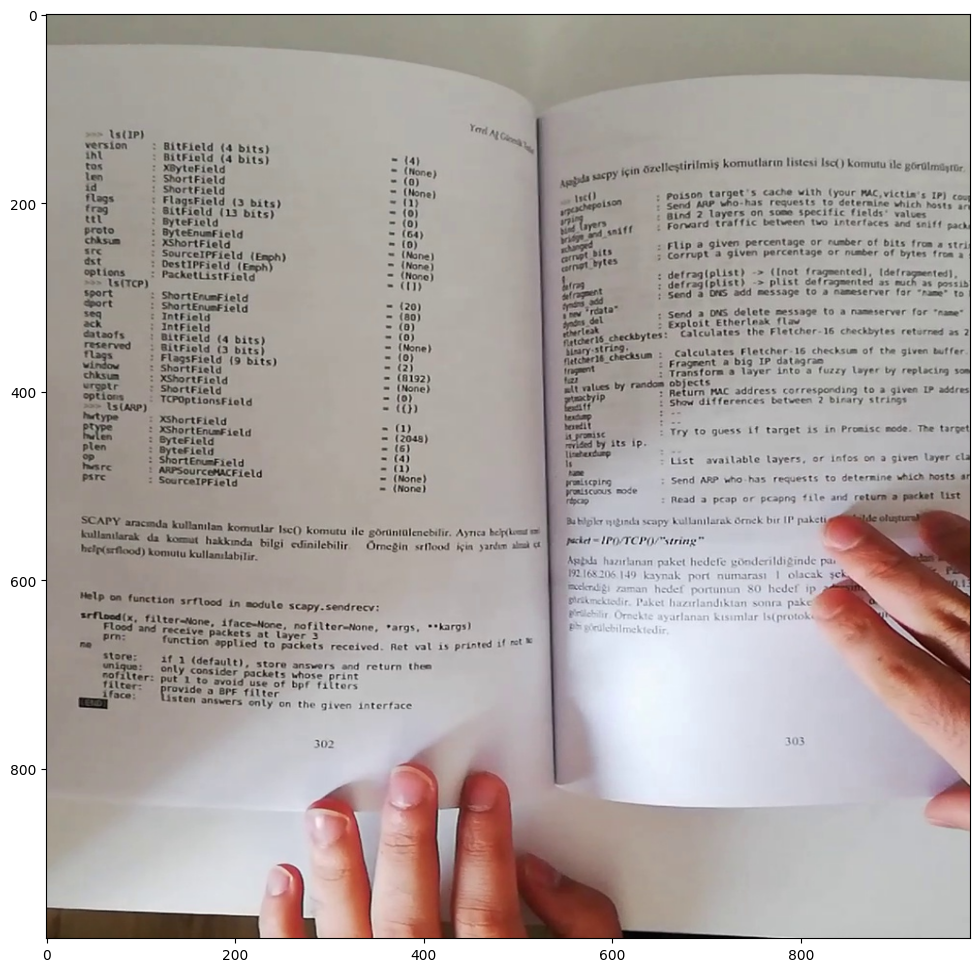

'User: You are given an image of an open book. Your task is to extract the words on the open page. Do not add any additional text.<image>Extract the text that is on the page in the image. Do not extrapolate or add any additional text to your repsonse.\nAssistant: 302\n303'

In [29]:
generated_text = text_extraction(path_to_training_images, random_image, size=980)
generated_text

Idefics is not that great at extracting text from foreign languages.

The next section will look at Google's Gemini 2.0 model to see if there is better performance.

## Gemini 2.0

https://ai.google.dev/gemini-api/docs/text-generation?lang=python

In [30]:
from google import genai
from google.colab import userdata

### make sure to use your own API key for this line
GEMINI_API_KEY = userdata.get('gemini_api_key')

GEMINI_API_KEY = GEMINI_API_KEY

client = genai.Client(api_key=GEMINI_API_KEY)

image = genesis1

response1 = client.models.generate_content(
    model="gemini-2.0-flash",
    contents=[image, "Extract the text that is on the open page of the image. Do not add any extra text or special characters to your response. If sentences are incomplete, do not extract that text in your response."])

genesis1_response = response1.text

In [31]:
genesis1_response

'GENESIS\nThe Book of Genesis is divided as follows:\n1. The Primeval History (1, 1-11, 26)\n11: The Patriarch Abraham (11, 27-25, 18)\n111: The Patriarchs Isaac and Jacob (25,\n19-36, 43)\nIV: Joseph and His Brothers (37, 1-50, 26)\nI: The Primeval History\n1\nFirst Story of Creation\nIn the beginning, when God created the\nheavens and the earth, the earth was a\nformless wasteland, and darkness cov-\nered the abyss, while a mighty wind\nswept over the waters.\nThen God said, "Let there be light,"\nand there was light. God saw how good\nthe light was. God then separated the\nlight from the darkness. God called the\nlight "day," and the darkness he called\n"night." Thus evening came, and morn-\ning followed-the first day.\nThen God said, "Let there be a dome\nin the middle of the waters, to separate\none body of water from the other." And\nso it happened: God made the dome,\nand it separated the water above the\ndome from the water below it. God\ncalled the dome "the sky." Evening\ncam

In [32]:
# with open('drive/MyDrive/project_4/gemini_genesis_response.txt', 'r') as file:
#   lines = file.readlines()
#   lines = [re.sub(r'\s', ' ', line) for line in lines]

In [33]:
genesis1_list = genesis1_response.split()
genesis1_list[44:50]

['1', 'First', 'Story', 'of', 'Creation', 'In']

In [34]:
## bleu score on Gemini 2.0 model

bleu_score = sentence_bleu([genesis1_ground_truth_list], genesis1_list[44:-197]) ## makes sure to cut out the extra text that is in the image but not the ground truth text

print(f"Gemini 2.0 bleu score of Genesis1 image: {round(bleu_score, 4)*100}%")

Gemini 2.0 bleu score of Genesis1 image: 2.9899999999999998%


In [35]:
image = Image.open(path_to_training_images+'/'+random_image)

response2 = client.models.generate_content(
    model="gemini-2.0-flash",
    contents=[image, "Extract the text that is on the open page of the image. Do not add any extra text or special characters to your response. If sentences are incomplete, do not extract that text in your response."])

random_image_response = response2.text
print(random_image_response)

ls(IP)
version
BitField (4 bits)
(4)
BitField (4 bits)
(None)
tos
: XByteField
len
: ShortField
id
ShortField
(None)
flags
:FlagsField (3 bits)
(1)
frag
BitField (13 bits)
ttl
ByteField
(0)
proto
: ByteEnumField
chksum
: XShortField
(0)
src
: SourceIPField (Emph)
(None)
dst
: DestIPField (Emph)
(None)
options
: PacketListField
(None)
>>1s(TCP)
(11)
sport
ShortEnumField
dport
: ShortEnumField
seq
: IntField
(8)
ack
: IntField
dataofs
(0)
BitField (4 bits)
(None)
reserved
BitField (3 bits)
flags
: FlagsField (9 bits)
(2)
window
: ShortField
chksum
: XShortField
(8192)
(None)
uroptr
: ShortField
(0)
options
TCPOptions Field
(())
1s (ARP)
hutype
: XShortField
ptype
: XShortEnumField
(2048)
helen
: ByteField
plen
: ByteField
op
: ShortEnumField
(4)
hwsrc
ARPSourceMACField
(None)
psrc
:SourceIPField
(None)
SCAPY aracımda kullanılan komutlar Ise() komutu ile görüntülenebilir. Ayrıca helpom
kullanılarak da komut hakkında bilgi edinilebilir. Örneğin srflood için yardım alma
help(srflood) komutu

In [36]:
# with open('drive/MyDrive/project_4/gemini_random_image_response.txt', 'w') as file:
#   file.write(random_image_response)

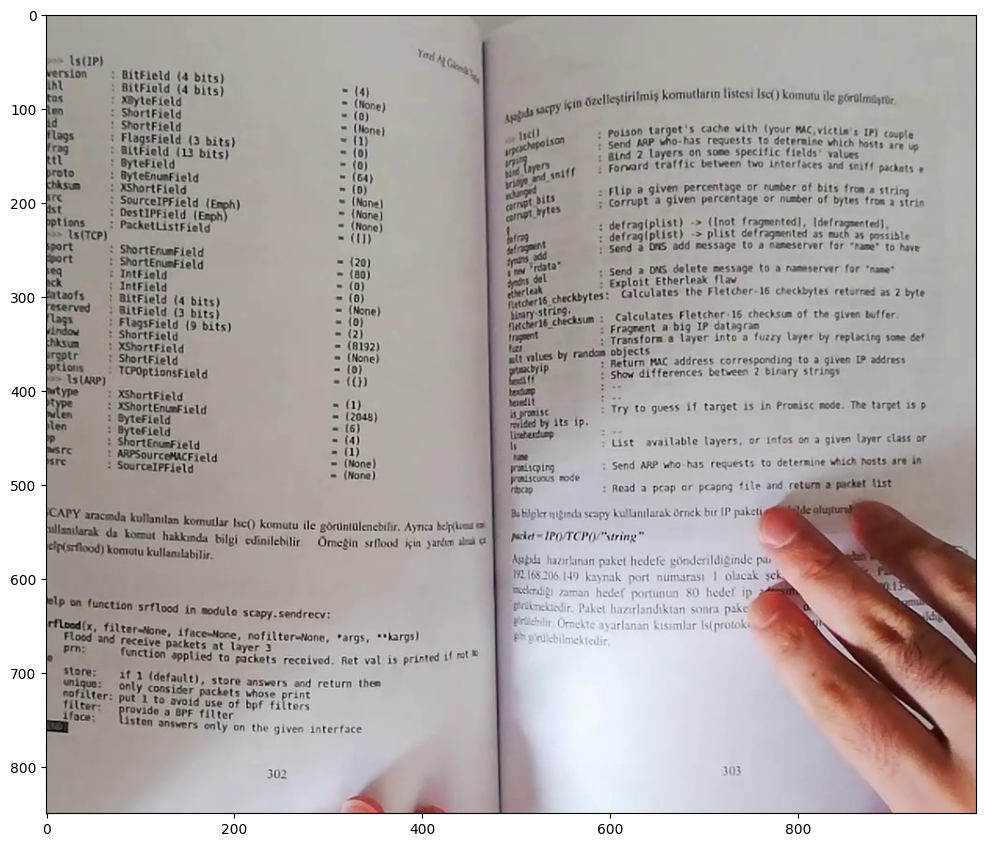

In [37]:
img = Image.open(path_to_training_images+'/'+random_image)
plt.figure(figsize=(12,12))
img = img.crop((90, 450, 1080, 1300))
plt.imshow(img)
plt.show()

We can see that the Gemini 2.0 model does a better job at extracting the text from this image.

Again, like I mentioned in the initial cell of the notebook, If we had a ground truth to look at for these images we could measure how good these translations are.

The Gemini model performs better in later notebooks.

## Speech-to-Text

### SpeechT5

https://huggingface.co/docs/transformers/en/model_doc/speecht5

https://huggingface.co/blog/speecht5

https://huggingface.co/learn/audio-course/en/chapter6/tts_datasets

In [38]:
%%capture
!pip install datasets[audio]==3.6.0

In [39]:
from transformers import SpeechT5Processor, SpeechT5ForTextToSpeech, SpeechT5HifiGan, set_seed, SpeechT5Tokenizer
from datasets import load_dataset

processor = SpeechT5Processor.from_pretrained("microsoft/speecht5_tts")
model = SpeechT5ForTextToSpeech.from_pretrained("microsoft/speecht5_tts")
vocoder = SpeechT5HifiGan.from_pretrained("microsoft/speecht5_hifigan")

preprocessor_config.json:   0%|          | 0.00/433 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/232 [00:00<?, ?B/s]

spm_char.model:   0%|          | 0.00/238k [00:00<?, ?B/s]

added_tokens.json:   0%|          | 0.00/40.0 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/234 [00:00<?, ?B/s]

config.json: 0.00B [00:00, ?B/s]

pytorch_model.bin:   0%|          | 0.00/585M [00:00<?, ?B/s]

config.json:   0%|          | 0.00/636 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/585M [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/50.7M [00:00<?, ?B/s]

In [40]:
## generic audio dataset with (1,512) vector audio embeddings
# dataset = load_dataset("Matthijs/cmu-arctic-xvectors.py", split="validation")

# print(f"Dataset keys: {dataset[0].keys()}") ## you can note that there is no 'text' or 'raw text' to compare the audio with

In [41]:
## text to speech
# inputs = processor(text=genesis1_response[:550], return_tensors="pt")
# speaker_embeddings = torch.tensor(dataset[7306]["xvector"]).unsqueeze(0)

# # generate speech
# speech = model.generate(inputs["input_ids"], speaker_embeddings=speaker_embeddings, vocoder=vocoder)

In [42]:
%%capture
!pip install ffmpeg

In [43]:
import soundfile as sf
from IPython.display import Audio
import ffmpeg

In [44]:
# sf.write(f"genesis1_tts_generic.wav", speech.numpy(), samplerate=16000)

In [45]:
# Audio(f"genesis1_tts_generic.wav", autoplay=False)

In [46]:
## better audio dataset to test with
dataset = load_dataset("VladislavKaryukin/AmericanEnglishTTS", split='train')

README.md:   0%|          | 0.00/721 [00:00<?, ?B/s]

data/train-00000-of-00001.parquet:   0%|          | 0.00/479M [00:00<?, ?B/s]

Generating train split:   0%|          | 0/3837 [00:00<?, ? examples/s]

In [47]:
dataset[0]

{'audio': {'path': 'f0001_us_f0001_00001.wav',
  'array': array([ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
         -2.44140625e-04, -1.83105469e-04, -6.10351562e-05]),
  'sampling_rate': 16000},
 'script': 'the world needs opportunities for new leaders and new ideas.',
 'source': 'OpenSLR',
 'info': 'A free American English corpus by Surfingtech'}

In [48]:
torchcodec.__version__

'0.6.0'

In [49]:
for i in range(len(dataset[5:10]['audio'])):
  sf.write(f'tts_english_{i}.wav', dataset[i]['audio']['array'], samplerate=dataset[i]['audio']['sampling_rate'])

  display(Audio(f'tts_english_{i}.wav', autoplay=False))

In [50]:
from speechbrain.pretrained import EncoderClassifier
import torchaudio

## these lines create x-vector embeddings for the audio file that is provided
## without the x-vector embeddings, the SpeechT5 model will not work because the matrices will not be compatable for mulitiplication

# Load pre-trained x-vector model
classifier = EncoderClassifier.from_hparams(source="speechbrain/spkrec-xvect-voxceleb", savedir="tmp")

# Load your audio file
signal, fs = torchaudio.load("tts_english_0.wav")

# Extract x-vector
xvector = classifier.encode_batch(signal)

/usr/local/lib/python3.12/dist-packages/speechbrain/utils/torch_audio_backend.py:57: UserWarning: torchaudio._backend.list_audio_backends has been deprecated. This deprecation is part of a large refactoring effort to transition TorchAudio into a maintenance phase. The decoding and encoding capabilities of PyTorch for both audio and video are being consolidated into TorchCodec. Please see https://github.com/pytorch/audio/issues/3902 for more information. It will be removed from the 2.9 release. 
  available_backends = torchaudio.list_audio_backends()
DEBUG:speechbrain.utils.checkpoints:Registered checkpoint save hook for _speechbrain_save
DEBUG:speechbrain.utils.checkpoints:Registered checkpoint load hook for _speechbrain_load
DEBUG:speechbrain.utils.checkpoints:Registered checkpoint save hook for save
DEBUG:speechbrain.utils.checkpoints:Registered checkpoint load hook for load
DEBUG:speechbrain.utils.checkpoints:Registered checkpoint save hook for _save
DEBUG:speechbrain.utils.checkpoi

hyperparams.yaml: 0.00B [00:00, ?B/s]

DEBUG:speechbrain.utils.fetching:Fetch: Local file found, creating symlink '/root/.cache/huggingface/hub/models--speechbrain--spkrec-xvect-voxceleb/snapshots/56895a2df401be4150a159f3a1c653f00051d477/hyperparams.yaml' -> '/content/tmp/hyperparams.yaml'
INFO:speechbrain.utils.fetching:Fetch custom.py: Fetching from HuggingFace Hub 'speechbrain/spkrec-xvect-voxceleb' if not cached
DEBUG:speechbrain.utils.checkpoints:Registered checkpoint save hook for _save
DEBUG:speechbrain.utils.checkpoints:Registered checkpoint load hook for _load
DEBUG:speechbrain.utils.checkpoints:Registered parameter transfer hook for _load
/usr/local/lib/python3.12/dist-packages/speechbrain/utils/autocast.py:188: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  wrapped_fwd = torch.cuda.amp.custom_fwd(fwd, cast_inputs=cast_inputs)
DEBUG:speechbrain.utils.checkpoints:Registered checkpoint save hook for save
DEBUG:speechbrain.u

embedding_model.ckpt:   0%|          | 0.00/16.9M [00:00<?, ?B/s]

DEBUG:speechbrain.utils.fetching:Fetch: Local file found, creating symlink '/root/.cache/huggingface/hub/models--speechbrain--spkrec-xvect-voxceleb/snapshots/56895a2df401be4150a159f3a1c653f00051d477/embedding_model.ckpt' -> '/content/tmp/embedding_model.ckpt'
DEBUG:speechbrain.utils.parameter_transfer:Set local path in self.paths["embedding_model"] = /content/tmp/embedding_model.ckpt
INFO:speechbrain.utils.fetching:Fetch mean_var_norm_emb.ckpt: Fetching from HuggingFace Hub 'speechbrain/spkrec-xvect-voxceleb' if not cached


mean_var_norm_emb.ckpt:   0%|          | 0.00/3.20k [00:00<?, ?B/s]

DEBUG:speechbrain.utils.fetching:Fetch: Local file found, creating symlink '/root/.cache/huggingface/hub/models--speechbrain--spkrec-xvect-voxceleb/snapshots/56895a2df401be4150a159f3a1c653f00051d477/mean_var_norm_emb.ckpt' -> '/content/tmp/mean_var_norm_emb.ckpt'
DEBUG:speechbrain.utils.parameter_transfer:Set local path in self.paths["mean_var_norm_emb"] = /content/tmp/mean_var_norm_emb.ckpt
INFO:speechbrain.utils.fetching:Fetch classifier.ckpt: Fetching from HuggingFace Hub 'speechbrain/spkrec-xvect-voxceleb' if not cached


classifier.ckpt:   0%|          | 0.00/15.9M [00:00<?, ?B/s]

DEBUG:speechbrain.utils.fetching:Fetch: Local file found, creating symlink '/root/.cache/huggingface/hub/models--speechbrain--spkrec-xvect-voxceleb/snapshots/56895a2df401be4150a159f3a1c653f00051d477/classifier.ckpt' -> '/content/tmp/classifier.ckpt'
DEBUG:speechbrain.utils.parameter_transfer:Set local path in self.paths["classifier"] = /content/tmp/classifier.ckpt
INFO:speechbrain.utils.fetching:Fetch label_encoder.txt: Fetching from HuggingFace Hub 'speechbrain/spkrec-xvect-voxceleb' if not cached


label_encoder.txt: 0.00B [00:00, ?B/s]

DEBUG:speechbrain.utils.fetching:Fetch: Local file found, creating symlink '/root/.cache/huggingface/hub/models--speechbrain--spkrec-xvect-voxceleb/snapshots/56895a2df401be4150a159f3a1c653f00051d477/label_encoder.txt' -> '/content/tmp/label_encoder.ckpt'
DEBUG:speechbrain.utils.parameter_transfer:Set local path in self.paths["label_encoder"] = /content/tmp/label_encoder.ckpt
INFO:speechbrain.utils.parameter_transfer:Loading pretrained files for: embedding_model, mean_var_norm_emb, classifier, label_encoder
DEBUG:speechbrain.utils.parameter_transfer:Redirecting (loading from local path): embedding_model -> /content/tmp/embedding_model.ckpt
DEBUG:speechbrain.utils.parameter_transfer:Redirecting (loading from local path): mean_var_norm_emb -> /content/tmp/mean_var_norm_emb.ckpt
DEBUG:speechbrain.utils.parameter_transfer:Redirecting (loading from local path): classifier -> /content/tmp/classifier.ckpt
DEBUG:speechbrain.utils.parameter_transfer:Redirecting (loading from local path): label_e

In [51]:
inputs = processor(text=genesis1_response[:600], return_tensors="pt")

speaker_embeddings = torch.tensor(xvector[0][0].tolist()).unsqueeze(0)

print(f'Speaker embeddings dtype: {speaker_embeddings.dtype}')
print(f'Speaker embeddings shape: {speaker_embeddings.shape}')
inputs['input_ids'] = inputs['input_ids'].to(torch.long)

# generate speech
speech = model.generate(inputs["input_ids"], speaker_embeddings=speaker_embeddings, vocoder=vocoder)

Speaker embeddings dtype: torch.float32
Speaker embeddings shape: torch.Size([1, 512])


Passing a tuple of `past_key_values` is deprecated and will be removed in Transformers v4.58.0. You should pass an instance of `EncoderDecoderCache` instead, e.g. `past_key_values=EncoderDecoderCache.from_legacy_cache(past_key_values)`.


In [52]:
sf.write("genesis1_tts_better.wav", speech.numpy(), samplerate=16000)
Audio("genesis1_tts_better.wav", autoplay=False)

### Canto 1 Example

In [53]:
canto1_response = client.models.generate_content(
    model="gemini-2.0-flash",
    contents=[canto1, "Extract the text that is on the open page of the image. Do not add any extra text or special characters to your response. If sentences are incomplete, do not extract that text in your response."])
print(canto1_response.text)

Canto I
E'en* such made me that beast withouten peace, 10
Which, coming on against me by degrees,
Thrust me back thither where the sun is silent.
While I was rushing downward to the lowland,
Before mine eyes did one present himself,
Who seemed from long-continued silence hoarse.
When I beheld him in the desert vast,
"Have pity on me,"11 unto him I cried,
"Whiche'er thou art, or shade or real man!"
He answered me: "Not man; man once I was, 12
And both my parents were of Lombardy,
And Mantuans by country both of them.
Sub Julio was I born, though it was late,
And lived at Rome under the good Augustus,
During the time of false and lying gods.
A Poet was I, and I sang that just
Son of Anchises, who came forth from Troy,
After that Ilion** the superb was burned.
But thou, why goest thou back to such annoyance?
Why climb'st thou not the Mount Delectable,"
Which is the source and cause of every joy?'
"Now, art thou that Virgilius13 and that fountain
Which spreads abroad so wide a river of spe

In [54]:
canto1_response = canto1_response.text[:-99]

In [55]:
## text to speech
inputs = processor(text=canto1_response[:600], return_tensors="pt")
speaker_embeddings = torch.tensor(xvector[0][0].tolist()).unsqueeze(0)

# generate speech
speech = model.generate(inputs["input_ids"], speaker_embeddings=speaker_embeddings, vocoder=vocoder)

In [56]:
sf.write("canto1_tts_better.wav", speech.numpy(), samplerate=16000)
Audio("canto1_tts_better.wav", autoplay=False)

As we can hear from these examples that the T5 TTS model generates human like audio fairly well, but there is a lot of noise and after a while the audio becomes inaudible.

Going from here, Sesame and Dia will offer drastically better human like generated voices!

### Turkish Audio

In [57]:
turkish_audio = load_dataset("ysdede/khanacademy-turkish", split='train')
len(turkish_audio)

README.md: 0.00B [00:00, ?B/s]

train-00000-of-00003.parquet:   0%|          | 0.00/392M [00:00<?, ?B/s]

train-00001-of-00003.parquet:   0%|          | 0.00/398M [00:00<?, ?B/s]

train-00002-of-00003.parquet:   0%|          | 0.00/397M [00:00<?, ?B/s]

test-00000-of-00001.parquet:   0%|          | 0.00/62.7M [00:00<?, ?B/s]

Generating train split:   0%|          | 0/25741 [00:00<?, ? examples/s]

Generating test split:   0%|          | 0/1355 [00:00<?, ? examples/s]

25741

In [58]:
turkish_audio[0]

{'transcription': 'Bunu belirleyen iki dinamik var birincisi litre başına sabit maliyetimizi Asgariye düşürebilmek için mümkün olduğunca çok üretmek isteriz.',
 'audio': {'path': 'chunk_20.opus',
  'array': array([-1.67695059e-11, -3.15520492e-11, -6.77465861e-11, ...,
         -1.57041475e-02,  1.22356256e-02, -7.41708232e-03]),
  'sampling_rate': 16000}}

In [59]:
sf.write('tts_turkish_1.wav', turkish_audio[0]['audio']['array'], samplerate=16000)

In [60]:
Audio('tts_turkish_1.wav', autoplay=False)

In [61]:
## do the same thing as with the English audio dataset up above

# Load pre-trained x-vector model
classifier = EncoderClassifier.from_hparams(source="speechbrain/spkrec-xvect-voxceleb", savedir="tmp")

# Load your audio file
signal, fs = torchaudio.load("tts_turkish_1.wav")

# Extract x-vector
xvector_turkish = classifier.encode_batch(signal)

INFO:speechbrain.utils.fetching:Fetch hyperparams.yaml: Using symlink found at '/content/tmp/hyperparams.yaml'
INFO:speechbrain.utils.fetching:Fetch custom.py: Fetching from HuggingFace Hub 'speechbrain/spkrec-xvect-voxceleb' if not cached
DEBUG:speechbrain.utils.parameter_transfer:Collecting files (or symlinks) for pretraining in tmp.
INFO:speechbrain.utils.fetching:Fetch embedding_model.ckpt: Using symlink found at '/content/tmp/embedding_model.ckpt'
DEBUG:speechbrain.utils.parameter_transfer:Set local path in self.paths["embedding_model"] = /content/tmp/embedding_model.ckpt
INFO:speechbrain.utils.fetching:Fetch mean_var_norm_emb.ckpt: Using symlink found at '/content/tmp/mean_var_norm_emb.ckpt'
DEBUG:speechbrain.utils.parameter_transfer:Set local path in self.paths["mean_var_norm_emb"] = /content/tmp/mean_var_norm_emb.ckpt
INFO:speechbrain.utils.fetching:Fetch classifier.ckpt: Using symlink found at '/content/tmp/classifier.ckpt'
DEBUG:speechbrain.utils.parameter_transfer:Set local 

In [62]:
inputs = processor(text=random_image_response[:600], return_tensors="pt")

speaker_embeddings = torch.tensor(xvector_turkish[0][0].tolist()).unsqueeze(0)

# speaker_embeddings = torch.Tensor.double(speaker_embeddings)
print(speaker_embeddings.dtype)
print(speaker_embeddings.shape)
inputs['input_ids'] = inputs['input_ids'].to(torch.long)

# generate speech
speech = model.generate(inputs["input_ids"], speaker_embeddings=speaker_embeddings, vocoder=vocoder)

torch.float32
torch.Size([1, 512])


In [63]:
sf.write("turkish_tts_better.wav", speech.numpy(), samplerate=16000)
Audio("turkish_tts_better.wav", autoplay=False)

With the T5 TTS model there is a capability to train it on other voices other than English, but I would need a Turkish speaker to measure the quality of the ouput.

I wanted to let people know that this model was able to train on different languages.

I don't believe that Sesame can be trained on different languages, but I am sure that Dia could.

In [64]:
random_image_response

'ls(IP)\nversion\nBitField (4 bits)\n(4)\nBitField (4 bits)\n(None)\ntos\n: XByteField\nlen\n: ShortField\nid\nShortField\n(None)\nflags\n:FlagsField (3 bits)\n(1)\nfrag\nBitField (13 bits)\nttl\nByteField\n(0)\nproto\n: ByteEnumField\nchksum\n: XShortField\n(0)\nsrc\n: SourceIPField (Emph)\n(None)\ndst\n: DestIPField (Emph)\n(None)\noptions\n: PacketListField\n(None)\n>>1s(TCP)\n(11)\nsport\nShortEnumField\ndport\n: ShortEnumField\nseq\n: IntField\n(8)\nack\n: IntField\ndataofs\n(0)\nBitField (4 bits)\n(None)\nreserved\nBitField (3 bits)\nflags\n: FlagsField (9 bits)\n(2)\nwindow\n: ShortField\nchksum\n: XShortField\n(8192)\n(None)\nuroptr\n: ShortField\n(0)\noptions\nTCPOptions Field\n(())\n1s (ARP)\nhutype\n: XShortField\nptype\n: XShortEnumField\n(2048)\nhelen\n: ByteField\nplen\n: ByteField\nop\n: ShortEnumField\n(4)\nhwsrc\nARPSourceMACField\n(None)\npsrc\n:SourceIPField\n(None)\nSCAPY aracımda kullanılan komutlar Ise() komutu ile görüntülenebilir. Ayrıca helpom\nkullanılarak da 

Please see the Sesame_Audio notebook for next part of project